In [1]:
import clip
import json
import torch
import umap
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
from pathlib import Path
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from typing import Union, Tuple, List, Dict
from clip2mesh.utils import plot_scatter_with_thumbnails


device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

def get_encoded_images(images_dir: Union[Path, str]) -> Tuple[List[np.array], List[np.array], List[np.array]]:

    encoded_images = []
    images = []
    preprocessed_images = []
    images_generator = list(Path(images_dir).rglob("*.png"))

    for image in tqdm(images_generator, total=len(images_generator), desc="Encoding images"):
        images.append(np.array(Image.open(image)))
        image = preprocess(Image.open(image)).unsqueeze(0).to(device)
        preprocessed_images.append(image)
        with torch.no_grad():
            image_features = model.encode_image(image).cpu().numpy()
        encoded_images.append(image_features)

    encoded_images = np.concatenate(encoded_images, axis=0)
    return encoded_images, images, preprocessed_images

def cluster_images_w_umap(images_embedding: np.ndarray, n_clusters: int) -> List[np.array]:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(images_embedding)
    return kmeans.labels_

def calc_top_descriptors(descriptors: List[str], preprocessed_images: np.ndarray, kmeans_labels: List[np.array]) -> Dict[int, List[str]]:
    tokenized_labels = clip.tokenize(descriptors).to(device)
    labels_count_for_class = {class_id: {label: 0 for label in descriptors} for class_id in np.unique(kmeans_labels)}
    for class_id, image in tqdm(zip(kmeans_labels, preprocessed_images), desc="finding best descriptors", total=preprocessed_images.__len__()):
        logits = model(image, tokenized_labels)[0]
        top_k_labels = [descriptors[i] for i in logits.topk(5).indices[0]]
        for label in top_k_labels:
            labels_count_for_class[class_id][label] += 1

    df = pd.DataFrame(labels_count_for_class)
    max_vals = df.idxmax(1)
    possible_words = {i: max_vals[max_vals == i].index.tolist() for i in np.unique(kmeans_labels)}

    return possible_words

def plot_clusters(possible_words: Dict[int, List[str]], kmeans_labels: List[np.array], images_embedding: np.ndarray, images: List[np.array]):
    class_names_dict = {i: " | ".join(possible_words[i]) for i in possible_words.keys()}
    class_labels = np.array([class_names_dict[i] for i in kmeans_labels.tolist()])
    plot = plot_scatter_with_thumbnails(images_embedding, images, class_labels, mark_size=100)
    plot.display()
    return class_labels


def write_words_clusters_to_json(possible_words: Dict[int, List[str]], json_path: Union[str, Path]):
    json_data = {str(i): possible_words[i] for i in possible_words.keys()}
    with open(json_path, "w") as f:
        json.dump(json_data, f, indent=4)


# function returns WSS score for k values from 1 to kmax
# refernce: https://medium.com/analytics-vidhya/how-to-determine-the-optimal-k-for-k-means-708505d204eb
def calculate_WSS(points: np.ndarray, kmax: int = 10) -> List[int]:
  sse = []
  for k in range(1, kmax+1):
    kmeans = KMeans(n_clusters = k).fit(points)
    centroids = kmeans.cluster_centers_
    pred_clusters = kmeans.predict(points)
    curr_sse = 0
    
    # calculate square of Euclidean distance of each point from its cluster center and add to current WSS
    for i in range(len(points)):
      curr_center = centroids[pred_clusters[i]]
      curr_sse += (points[i, 0] - curr_center[0]) ** 2 + (points[i, 1] - curr_center[1]) ** 2
      
    sse.append(curr_sse)
  return sse

def calculate_silhouette_score(points: np.ndarray, kmax: int = 10) -> List[float]:
    sil = []
    # dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
    for k in range(2, kmax+1):
        kmeans = KMeans(n_clusters = k).fit(points)
        labels = kmeans.labels_
        sil.append(silhouette_score(points, labels, metric = 'euclidean'))
    return sil

def plot_k_choosing(sil_scores: List[float], wss_scores: List[int], kmax: int = 10) -> int:
    fig, ax = plt.subplots(1, 1, figsize=(20, 8))

    ax.plot(range(1, kmax+1), wss_scores, color='blue', marker='o', label='WSS')
    ax.set_xlabel('Number of clusters', fontsize=16)
    ax.set_yticks([])
    ax.set_xticks(range(1, kmax+1))
    ax.set_ylim(0, np.max(wss_scores) + 1000)
    
    ax2 = ax.twinx()
    ax2.plot(range(2, kmax+1), sil_scores, color='green', marker='x', label='Silhouette score')
    ax2.vlines(x=np.argmax(sil_scores) + 2, ymin=0.0, ymax=np.max(sil_scores), color='red', linestyles='dashed', label='Best k')
    ax2.set_yticks([])

    fig.suptitle('Elbow Method vs Silhouette Method', fontsize=20)
    fig.legend(loc='upper right', ncol=3)
    fig.tight_layout()

    plt.show()

    return np.argmax(sil_scores) + 2

def get_best_k(images_embedding: np.ndarray, kmax: int = 10) -> int:
    wss_scores = calculate_WSS(images_embedding, kmax)
    sil_scores = calculate_silhouette_score(images_embedding, kmax)
    best_k = plot_k_choosing(sil_scores, wss_scores, kmax)
    return best_k

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


# BODY

Encoding images: 100%|██████████| 3643/3643 [01:14<00:00, 49.11it/s]


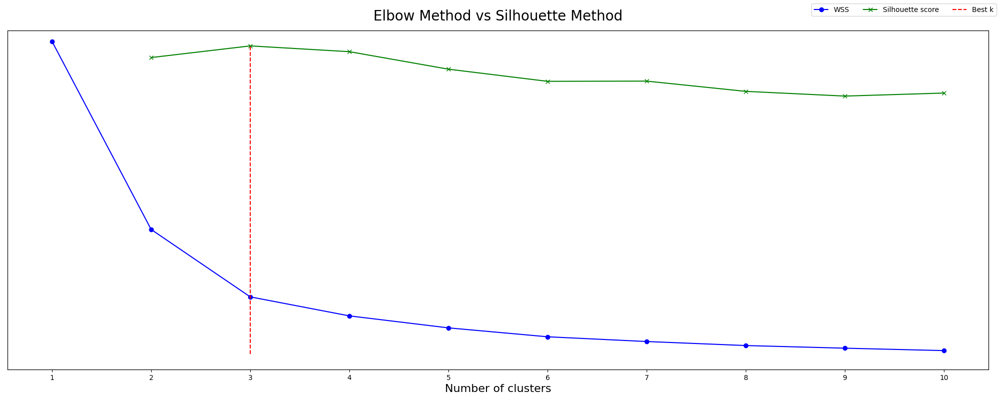

finding best descriptors: 100%|██████████| 3643/3643 [02:00<00:00, 30.29it/s]


alt.Chart(...)

In [2]:
images_dir = "/home/nadav2/dev/data/CLIP2Shape/images/smplx_py3d_male"
descriptors = ["fat", "thin", "muscular", "short", "long legs", "narrow waist", "skinny", "tall", "rectangular",
               "pear shaped", "average", "big", "curvy", "lean", "masculine", "proportioned", "stocky", 
               "sexy", "sturdy", "hourglass", "broad shoulders", "fit", "round apple", "built", "heavyset" ,"petite", "small"]

new_descriptors = [["fat"], ["thin"]]

encoded_images, images, preprocessed_images = get_encoded_images(images_dir=images_dir)
images_embedding = umap.UMAP(n_neighbors=300, min_dist=0.0, metric="euclidean").fit_transform(encoded_images)
best_k = get_best_k(images_embedding)
kmeans_labels = cluster_images_w_umap(encoded_images, n_clusters=best_k)
possible_words = calc_top_descriptors(descriptors, preprocessed_images, kmeans_labels)
plot_clusters(possible_words, kmeans_labels, images_embedding, images)
write_words_clusters_to_json(possible_words, "/home/nadav2/dev/data/CLIP2Shape/outs/clustering_images/words_jsons/smplx_male.json")

# FACE EXPRESSION

Encoding images: 100%|██████████| 978/978 [00:24<00:00, 40.42it/s]


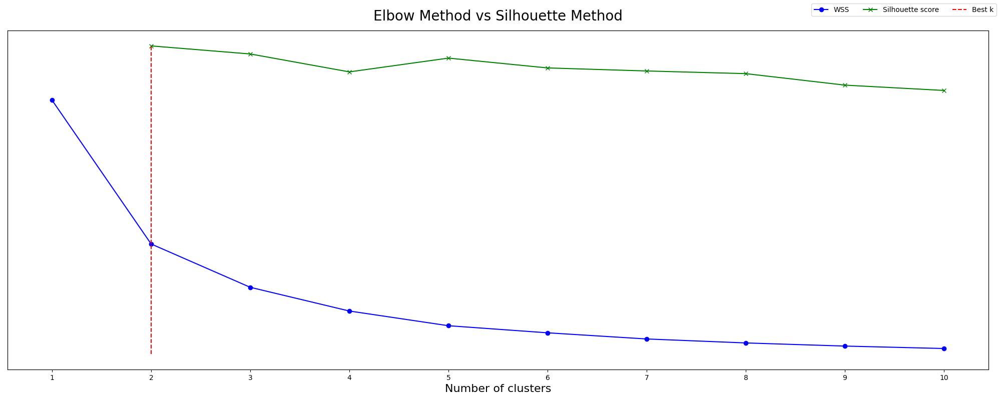

finding best k labels: 100%|██████████| 978/978 [00:19<00:00, 49.27it/s]


alt.Chart(...)

In [72]:
images_dir = "/home/nadav2/dev/data/CLIP2Shape/images/flame_textured_exp"
descriptors = ["smile", "happy", "sad", "angry", "furious", "disgusted", "funny face", "open mouth", "surprised", "raising eyebrows",
               "open eyes", "high mouth"]
               
encoded_images, images, preprocessed_images = get_encoded_images(images_dir=images_dir)
images_embedding = umap.UMAP(n_neighbors=150, min_dist=0.0, metric="euclidean").fit_transform(encoded_images)
best_k = get_best_k(images_embedding)
kmeans_labels = cluster_images_w_umap(encoded_images, n_clusters=best_k)
possible_words = calc_top_descriptors(descriptors, preprocessed_images, kmeans_labels)
plot_clusters(possible_words, kmeans_labels, images_embedding, images)
write_words_clusters_to_json(possible_words, "/home/nadav2/dev/data/CLIP2Shape/outs/clustering_images/words_jsons/flame_expression.json")

# FACE SHAPE

Encoding images: 100%|██████████| 992/992 [00:28<00:00, 34.80it/s]


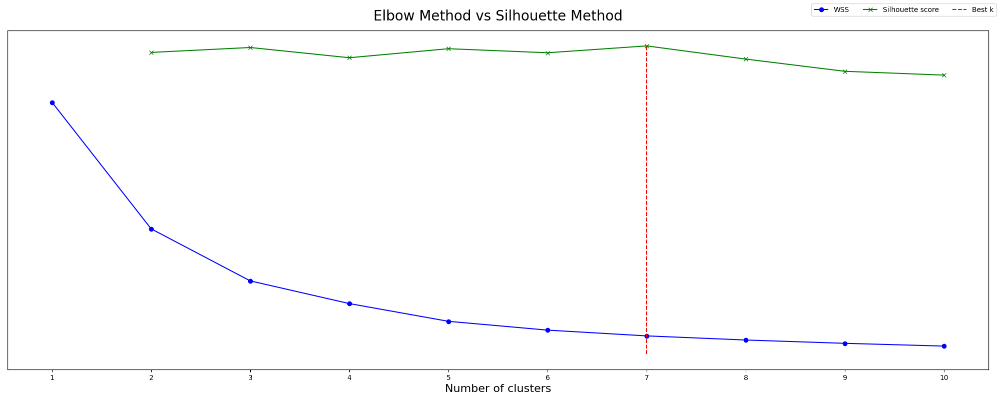

finding best k labels: 100%|██████████| 992/992 [00:17<00:00, 56.25it/s]


alt.Chart(...)

In [73]:
images_dir = "/home/nadav2/dev/data/CLIP2Shape/images/flame_textured"
descriptors = ["big forehead", "big nose", "ears sticking out", "long neck", "chubby cheeks", "sharp jaw", "fat face"]

encoded_images, images, preprocessed_images = get_encoded_images(images_dir=images_dir)
images_embedding = umap.UMAP(n_neighbors=150, min_dist=0.0, metric="euclidean").fit_transform(encoded_images)
best_k = get_best_k(images_embedding)
kmeans_labels = cluster_images_w_umap(encoded_images, n_clusters=best_k)
possible_words = calc_top_descriptors(descriptors, preprocessed_images, kmeans_labels)
plot_clusters(possible_words, kmeans_labels, images_embedding, images)
write_words_clusters_to_json(possible_words, "/home/nadav2/dev/data/CLIP2Shape/outs/clustering_images/words_jsons/flame_shape.json")

# SMAL

In [6]:
images_dir = "/home/nadav2/dev/data/CLIP2Shape/images/smal"
descriptors = ["big cats", "donkey", "cow", "hippo"]
encoded_images, images, preprocessed_images = get_encoded_images(images_dir=images_dir)
images_embedding, kmeans_labels = cluster_images_w_umap(encoded_images, n_clusters=4, n_neighbors=50)
possible_words = calc_top_descriptors(descriptors, preprocessed_images, kmeans_labels)
plot_clusters(possible_words, kmeans_labels, images_embedding, images)

finding best k labels: 100%|██████████| 636/636 [00:12<00:00, 49.25it/s]


alt.Chart(...)